<a href="https://colab.research.google.com/github/ElaYJ/Study_Deep_Learning/blob/main/DL_Project/YOLO_dataset_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## import

In [ ]:
import os
import json
import shutil
import random
import pandas as pd
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
from tqdm.notebook import tqdm

<br></br>

## utility function

### - draw bbox/image

In [ ]:
eng_class = {
    '잎':'leaf',
    '줄기':'stem',
    '화방':'flower',
    '과실':'fruit'
}
def draw_bboxes(img, annotations, categories):
    for anno, cate in zip(annotations, categories):
        rect = [int(round(x)) for x in anno['bbox']]
        cv2.rectangle(img, rec=rect, color=(0,0,255), thickness=2)
        cv2.putText(
            img, text=eng_class[cate['name']], org=(rect[0], rect[1]-5),
            fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=1.,
            color=(255,255,0), thickness=2, lineType=cv2.LINE_AA
        )

In [ ]:
gs_in_eng = {
    '정식기':'transplant',
    '출뢰기':'flower_bud',
    '개화기':'blossoming',
    '과실비대기':'fruit_enlarge',
    '수확기':'harvesting'
}
def show_sample_image(df, gs, num, src_dir, istrain=True, isbbox=False):
    f_list = df.query(f"growth_stage=='{gs}'")['fname'].values.tolist()
    print(f"--- < {gs}({gs_in_eng[gs]}) : {len(f_list)} > --- \n")

    rand_f = random.sample(population=f_list, k=num)
    rand_df = df[df['fname'].isin(rand_f)].reset_index()
    img_files = [x + '.jpg' for x in rand_f]

    # Iterate through the rand_img list and check if each file exists
    for fname in img_files:
        if not os.path.isfile(src_dir + fname):
            raise ValueError("Image file not found:", fname)

    rows = (num // 4 ) + 1
    plt.figure(figsize=(15,5*rows))
    for idx, fname in enumerate(img_files):
        img = cv2.imread(src_dir+fname)
        if isbbox:
            folder = "extracted_train" if istrain else "extracted_valid"
            fpath = f"/content/drive/MyDrive/DLP/label_data_json/{folder}/{rand_f[idx]}.json"
            if os.path.isfile(fpath):
                with open(fpath) as f:  data = json.load(f)
            else:
                raise ValueError("Json file not found:", fpath)
            draw_bboxes(img, data['annotations'], data['categories'])

        plt.subplot(rows,4,idx+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(rand_df.loc[idx, 'crops_id'] + ' [' + rand_df.loc[idx, 'c_date'] + ']')
        plt.axis("off")
    plt.show()

### - image crop & re text

In [ ]:
def get_info(json_dir, fname):
    file_path = json_dir + fname + ".json"
    if not os.path.isfile(file_path):
        raise ValueError("Json file not found:", file_path)

    with open(os.path.join(file_path)) as f:
        data = json.load(f)

    iw = float(data['images'].get('width'))
    ih = float(data['images'].get('height'))
    annotations = data['annotations']
    categories = data['categories']

    return iw, ih, annotations, categories

In [ ]:
def get_crop_points(annotations, width, height):
    pts_x=[]; pts_y=[];
    for annot in annotations:
        pts_x.append(annot['segmentation'][0])
        pts_x.append(annot['segmentation'][4])
        pts_y.append(annot['segmentation'][1])
        pts_y.append(annot['segmentation'][5])

    l = int(min(pts_x)) - 120
    if l < 0: l = 0
    r = int(max(pts_x)) + 120
    if r > width: r = int(width)
    t = int(min(pts_y)) - 120
    if t < 0: t = 0
    b = int(max(pts_y)) + 120
    if b > height: b = int(height)

    return l, t, r, b

In [ ]:
category = ['잎', '줄기', '화방', '과실']

# YOLO bbox 형식 : class x_center y_center width height
def get_bbox_text(annotations, categories, adjust_L, adjust_T, crop_width, crop_height):
    labels = []
    for anno, cate in zip(annotations, categories):
        class_ = category.index(cate['name'])
        left_shift = anno['bbox'][0] - adjust_L
        top_shift = anno['bbox'][1] - adjust_T
        x_center = round((left_shift + anno['bbox'][2]/2) / crop_width, 10)
        y_center = round((top_shift + anno['bbox'][3]/2) / crop_height, 10)
        width = round(anno['bbox'][2] / crop_width, 10)
        height = round(anno['bbox'][3] / crop_height, 10)
        label_info = f"{class_} {x_center} {y_center} {width} {height}"
        labels.append(label_info)

    return labels

In [ ]:
def save_bbox_text(save_dir, fname, txt_labels):
    with open(os.path.join(save_dir, fname + ".txt"), 'w') as f:
        for i, label in enumerate(txt_labels):
            if i+1 == len(txt_labels):
                f.write(label)
            else:
                f.write(label + '\n')

In [ ]:
def crop_dataset_generator(flist, json_dir, image_dir, save_img_dir, save_txt_dir):
    for fname in tqdm(flist, desc="Processing"):
        img_width, img_height, annotations, categories = get_info(json_dir, fname)
        cl, ct, cr, cb = get_crop_points(annotations, img_width, img_height)

        img_path = image_dir + fname + ".jpg"
        if not os.path.isfile(img_path):
            raise ValueError("Image file not found:", img_path)
        img = cv2.imread(img_path)

        crop_img = img[ct:cb, cl:cr]
        if not cv2.imwrite(save_img_dir+fname+".jpg", crop_img):
            print("Image Save Failed! -->", fname)
            break

        crop_h, crop_w = crop_img.shape[:2]
        txt_labels = get_bbox_text(annotations, categories, cl, ct, crop_w, crop_h)
        save_bbox_text(save_txt_dir, fname, txt_labels)

<br></br>

# train



## data sampling

In [ ]:
tm_df = pd.read_csv("/content/drive/MyDrive/DLP/train_meta_data.csv")
tm_df

,fname,image_id,farm_id,crops_id,crops_type,growth_stage,c_date,c_time,env1,env2,growth_info,etc_info,img_width,img_height,bbox_num,annotations,categories
0,C24_B02_003_753155,753155,AIF005,C24_B02,딸기 금실,출뢰기,2022-01-08,15:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1087,1440,10,"[{'segmentation': [656.78, 685.02, 704.33, 685...","[{'id': 0, 'name': '화방', 'supercategory': 'non..."
1,C24_B02_002_753133,753133,AIF005,C24_B02,딸기 금실,출뢰기,2022-01-08,12:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1121,1441,2,"[{'segmentation': [639.03, 524.27, 692.62, 524...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
2,C24_B02_003_753134,753134,AIF005,C24_B02,딸기 금실,출뢰기,2022-01-08,12:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1087,1440,10,"[{'segmentation': [655.86, 681.28, 708.9, 681....","[{'id': 0, 'name': '화방', 'supercategory': 'non..."
3,C24_B02_003_753162,753162,AIF005,C24_B02,딸기 금실,출뢰기,2022-01-08,17:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1087,1440,6,"[{'segmentation': [654.81, 685.55, 702.7, 685....","[{'id': 0, 'name': '화방', 'supercategory': 'non..."
4,C24_B02_005_753144,753144,AIF005,C24_B02,딸기 금실,출뢰기,2022-01-08,14:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1153,1277,4,"[{'segmentation': [316.88, 679.55, 527.79, 679...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24341,C22_B02_007_414673,414673,AIF005,C22_B02,딸기 금실,개화기,2021-08-29,06:46:51,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C22_B02', 'measured_date': None,...","{'corps_id': 'C22_B02', 'create_date': '', 'in...",1419,1910,12,"[{'segmentation': [1041.06, 439.31, 1367.39, 4...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
24342,C22_B02_005_414678,414678,AIF005,C22_B02,딸기 금실,출뢰기,2021-08-29,07:46:51,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C22_B02', 'measured_date': None,...","{'corps_id': 'C22_B02', 'create_date': '', 'in...",1286,1669,9,"[{'segmentation': [583.91, 522.4, 769.33, 522....","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
24343,C22_B02_002_414674,414674,AIF005,C22_B02,딸기 금실,정식기,2021-08-29,07:46:51,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C22_B02', 'measured_date': None,...","{'corps_id': 'C22_B02', 'create_date': '', 'in...",1389,2133,3,"[{'segmentation': [408.28, 327.55, 728.42, 327...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
24344,C22_B02_001_414689,414689,AIF005,C22_B02,딸기 금실,정식기,2021-08-29,09:46:51,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C22_B02', 'measured_date': None,...","{'corps_id': 'C22_B02', 'create_date': '', 'in...",1511,2064,6,"[{'segmentation': [20.75, 226.75, 428.42, 226....","[{'id': 0, 'name': '잎', 'supercategory': 'none..."


### - 정식기

In [ ]:
# 정식기 데이터 추출
train_transplant = []

for id in ['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']:
    df_raw = tm_df.query(f"crops_id=='{id}' & growth_stage=='정식기' & bbox_num>2")
    d_list = df_raw['c_date'].value_counts().to_frame().index.to_list()

    t_list = []
    for date in d_list:
        popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
        if len(popul) > 1:
            t_list += random.sample(popul, k=2)
        else:
            t_list += popul
    print(f"{id} [{len(d_list)} days] -->  {len(t_list)}개 데이터 추출")
    train_transplant += t_list

len(train_transplant)

C22_B02 [46 days] -->  92개 데이터 추출
C23_B02 [35 days] -->  70개 데이터 추출
C24_B02 [35 days] -->  70개 데이터 추출
C25_B02 [35 days] -->  70개 데이터 추출


302

### - 출뢰기

In [ ]:
# 출뢰기 데이터 추출
train_flowerbud = []

for id in ['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']:
    df_raw = tm_df.query(f"crops_id=='{id}' & growth_stage=='출뢰기' & bbox_num>2")
    d_list = df_raw['c_date'].value_counts().to_frame().index.to_list()

    t_list = []
    for date in d_list:
        popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
        if len(popul) > 1:
            t_list += random.sample(popul, k=1)
        else:
            t_list += popul
    print(f"{id} [{len(d_list)} days]\t-->  {len(t_list)}개 데이터 추출")
    train_flowerbud += t_list

len(train_flowerbud)

C22_B02 [121 days]	-->  121개 데이터 추출
C23_B02 [80 days]	-->  80개 데이터 추출
C24_B02 [90 days]	-->  90개 데이터 추출
C25_B02 [92 days]	-->  92개 데이터 추출


383

### - 개화기

In [ ]:
# 개화기 데이터 추출
train_blossoming = []

for i, id in enumerate(['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']):
    df_raw = tm_df.query(f"crops_id=='{id}' & growth_stage=='개화기' & bbox_num>2")
    d_list = df_raw['c_date'].value_counts().to_frame().index.to_list()

    t_list = []
    if i==2:
        for date in d_list:
            popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
            if len(popul) > 6:
                t_list += random.sample(popul, k=7)
            else:
                t_list += popul
        print(id, f'[{len(d_list)} days] --> ', len(t_list))
        train_blossoming += t_list
    else:
        for date in d_list:
            popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
            if len(popul) > 2:
                t_list += random.sample(popul, k=3)
            else:
                t_list += popul
        print(id, f'[{len(d_list)} days] --> ', len(t_list))
        train_blossoming += t_list

len(train_blossoming)

C22_B02 [52 days] -->  148
C23_B02 [54 days] -->  154
C24_B02 [25 days] -->  141
C25_B02 [68 days] -->  199


642

### - 과실비대기

In [ ]:
# 과실비대기 데이터 추출
train_fruitenlarge = []

for i, id in enumerate(['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']):
    df_raw = tm_df.query(f"crops_id=='{id}' & growth_stage=='과실비대기' & bbox_num>2")
    d_list = df_raw['c_date'].value_counts().to_frame().index.to_list()

    t_list = []
    if i==1:
        for date in d_list:
            popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
            if len(popul) > 1:
                t_list += random.sample(popul, k=2)
            else:
                t_list += popul
        print(id, f'[{len(d_list)} days] --> ', len(t_list))
        train_fruitenlarge += t_list
    else:
        for date in d_list:
            popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
            if len(popul) > 2:
                t_list += random.sample(popul, k=3)
            else:
                t_list += popul
        print(id, f'[{len(d_list)} days] --> ', len(t_list))
        train_fruitenlarge += t_list

len(train_fruitenlarge)

C22_B02 [76 days] -->  224
C23_B02 [113 days] -->  226
C24_B02 [95 days] -->  283
C25_B02 [71 days] -->  213


946

### - 수확기

In [ ]:
# 수확기 데이터 추출
train_harvesting = []

for i, id in enumerate(['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']):
    df_raw = tm_df.query(f"crops_id=='{id}' & growth_stage=='수확기' & bbox_num>2")
    d_list = df_raw['c_date'].value_counts().to_frame().index.to_list()

    t_list = []
    for date in d_list:
        popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
        if len(popul) > 1:
            t_list += random.sample(popul, k=2)
        else:
            t_list += popul
    if i==1:
        for date in d_list[:40]:
            popul = df_raw.query(f"c_date=='{date}'")['fname'].values.tolist()
            t_list += random.sample(popul, k=1)

    print(id, f'[{len(d_list)} days] --> ', len(t_list))
    train_harvesting += t_list

len(train_harvesting)

C22_B02 [125 days] -->  247
C23_B02 [101 days] -->  242
C24_B02 [110 days] -->  220
C25_B02 [123 days] -->  245


954

In [ ]:
train_data = train_transplant + train_flowerbud + train_blossoming + train_fruitenlarge + train_harvesting
train_data = set(train_data)
len(train_data)

3222

In [ ]:
extract_df = tm_df[tm_df['fname'].isin(train_data)]
gs_df = extract_df['growth_stage'].value_counts().to_frame()
gs_df['ratio'] = (gs_df['count'] / len(extract_df) * 100).round()
gs_df

,count,ratio
growth_stage,,
수확기,949,29.0
과실비대기,946,29.0
개화기,642,20.0
출뢰기,383,12.0
정식기,302,9.0


In [ ]:
extract_df.groupby(by=['crops_id','growth_stage']).agg({'image_id':'count'})

image_id
crops_id growth_stage          
C22_B02  개화기                148
         과실비대기              224
         수확기                247
         정식기                 92
         출뢰기                121
C23_B02  개화기                154
         과실비대기              226
         수확기                237
         정식기                 70
         출뢰기                 80
C24_B02  개화기                141
         과실비대기              283
         수확기                220
         정식기                 70
         출뢰기                 90
C25_B02  개화기                199
         과실비대기              213
         수확기                245
         정식기                 70
         출뢰기                 92

In [ ]:
len(extract_df['c_date'].unique())

151

In [ ]:
extract_df.to_csv("/content/drive/MyDrive/DLP/YOLO_train_data3.csv", index=False)

### - 데이터 확인

In [ ]:
train_list = extract_df['fname'].values.tolist()
len(train_list)

3222

In [ ]:
print(sorted(extract_df['bbox_num'].unique()), extract_df['bbox_num'].values.sum())

[3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 25, 26] 24376


In [ ]:
annot_df = pd.read_csv("/content/drive/MyDrive/DLP/train_annot_data.csv")
extract_annot = annot_df[annot_df['fname'].isin(train_list)].reset_index(drop=True)
extract_annot

,image_id,fname,segment,area,bbox,category
57,753142,C24_B02_004_753142,"[336.77, 580.07, 412.22, 580.07, 412.22, 659.6...",6006.61,"[336.77, 580.07, 75.46, 79.6]",화방
58,753142,C24_B02_004_753142,"[281.86, 592.94, 325.66, 592.94, 325.66, 638.8...",2012.61,"[281.86, 592.94, 43.8, 45.95]",화방
59,753142,C24_B02_004_753142,"[225.47, 635.99, 275.2, 635.99, 275.2, 693.82,...",2876.46,"[225.47, 635.99, 49.74, 57.83]",화방
60,753142,C24_B02_004_753142,"[276.42, 694.39, 344.46, 694.39, 344.46, 748.2...",3665.31,"[276.42, 694.39, 68.04, 53.87]",과실
61,753142,C24_B02_004_753142,"[326.88, 667.17, 395.21, 667.17, 395.21, 784.5...",8017.84,"[326.88, 667.17, 68.33, 117.34]",과실
...,...,...,...,...,...,...
173730,414668,C22_B02_001_414668,"[757.94, 678.05, 789.63, 678.05, 789.63, 931.2...",8024.54,"[757.94, 678.05, 31.69, 253.22]",줄기
173742,414669,C22_B02_003_414669,"[114.13, 1085.61, 407.14, 1085.61, 407.14, 123...",43632.11,"[114.13, 1085.61, 293.01, 148.91]",잎
173743,414669,C22_B02_003_414669,"[312.54, 1205.92, 533.28, 1205.92, 533.28, 140...",44437.16,"[312.54, 1205.92, 220.74, 201.31]",잎
173744,414669,C22_B02_003_414669,"[614.21, 536.52, 749.38, 536.52, 749.38, 601.2...",8756.31,"[614.21, 536.52, 135.17, 64.78]",줄기


In [ ]:
extract_annot['category'].value_counts().to_frame()

,count
category,
줄기,8452
잎,6382
과실,6206
화방,3336


In [ ]:
gs_list = list(in_eng.keys())
gs_list

['정식기', '출뢰기', '개화기', '과실비대기', '수확기']

--- < 정식기(transplant) : 302 > --- 



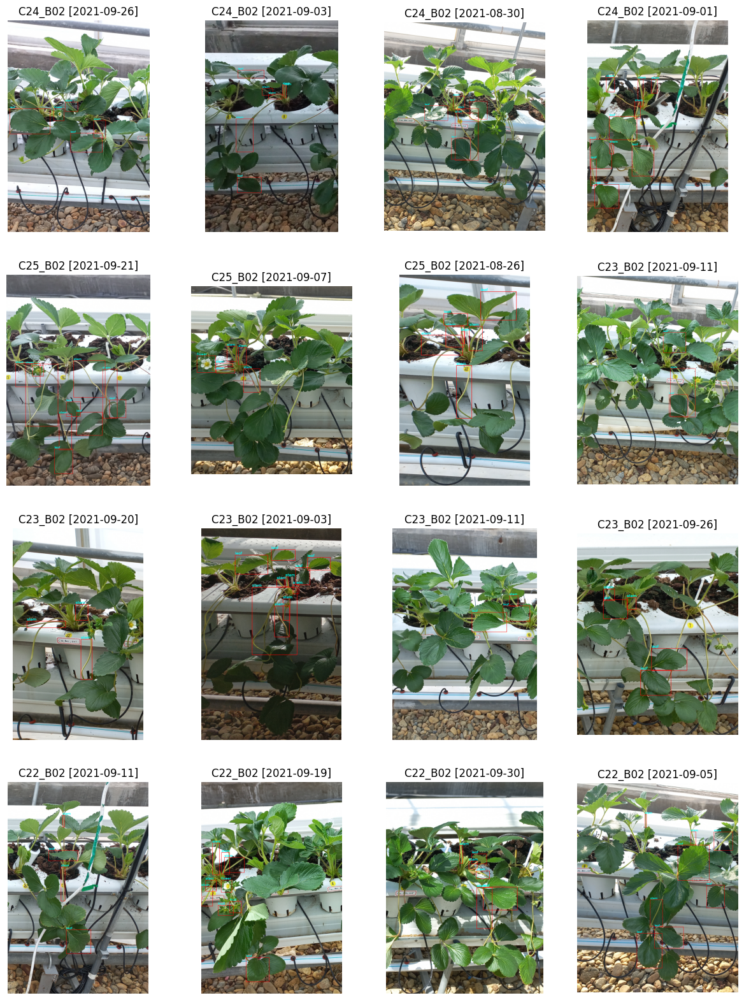

In [ ]:
src_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/train/images/"

show_sample_image(extract_df, gs_list[0], 16, src_dir, isbbox=True)

--- < 출뢰기(flower_bud) : 383 > --- 



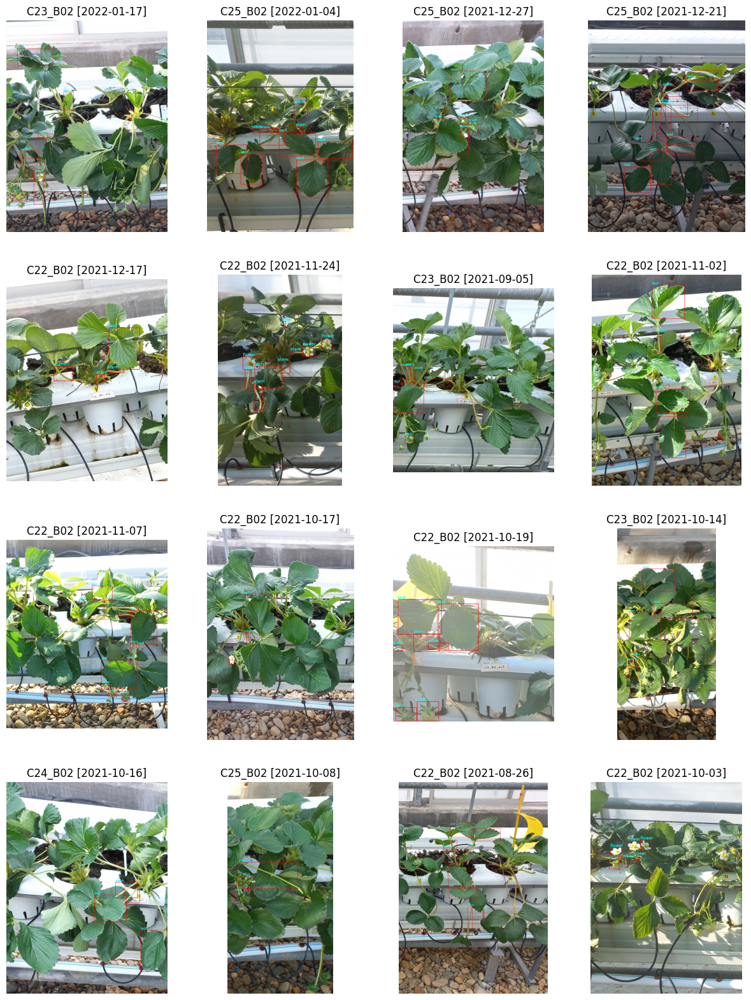

In [ ]:
show_sample_image(extract_df, gs_list[1], 16, src_dir, isbbox=True)

--- < 개화기(blossoming) : 642 > --- 



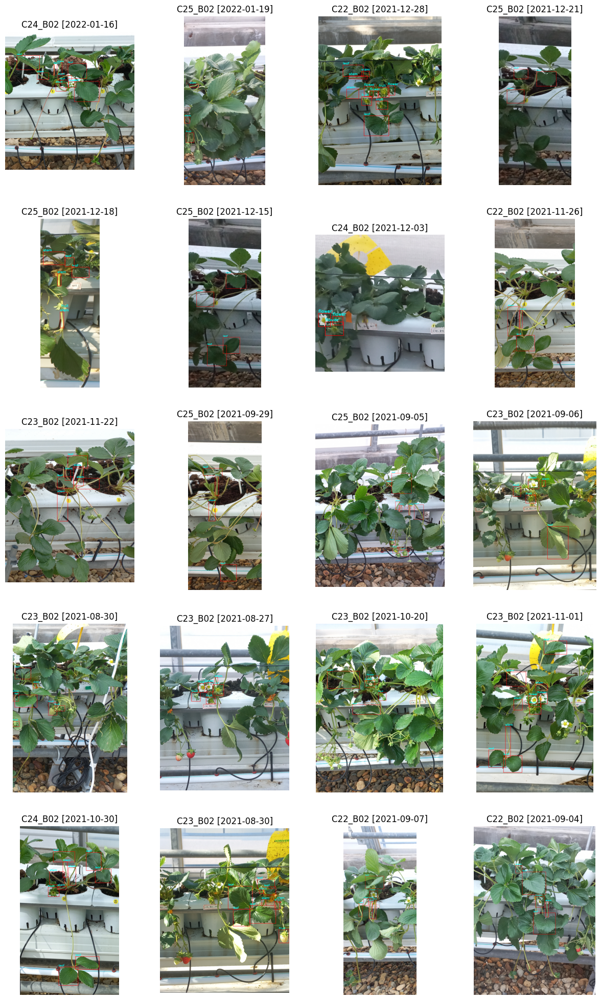

In [ ]:
show_sample_image(extract_df, gs_list[2], 20, src_dir, isbbox=True)

--- < 과실비대기(fruit_enlarge) : 946 > --- 



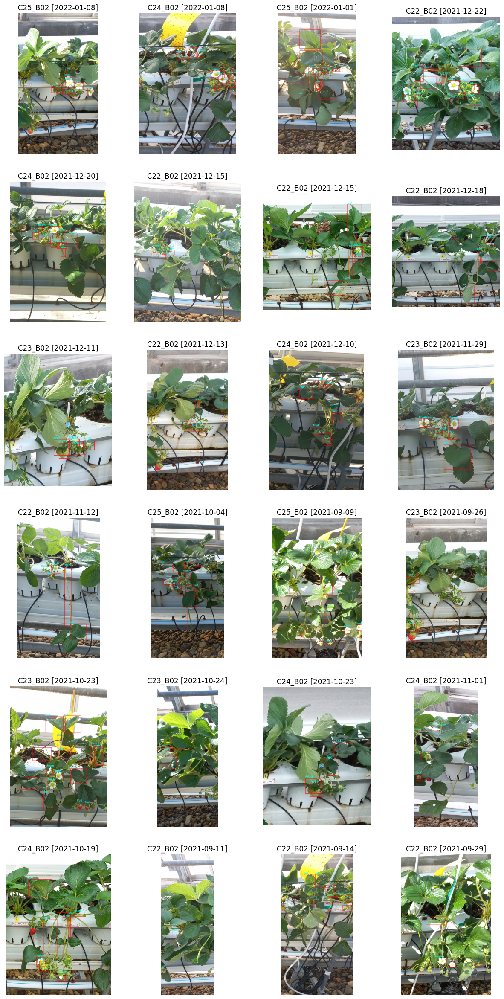

In [ ]:
show_sample_image(extract_df, gs_list[3], 24, src_dir, isbbox=True)

--- < 수확기(harvesting) : 949 > --- 



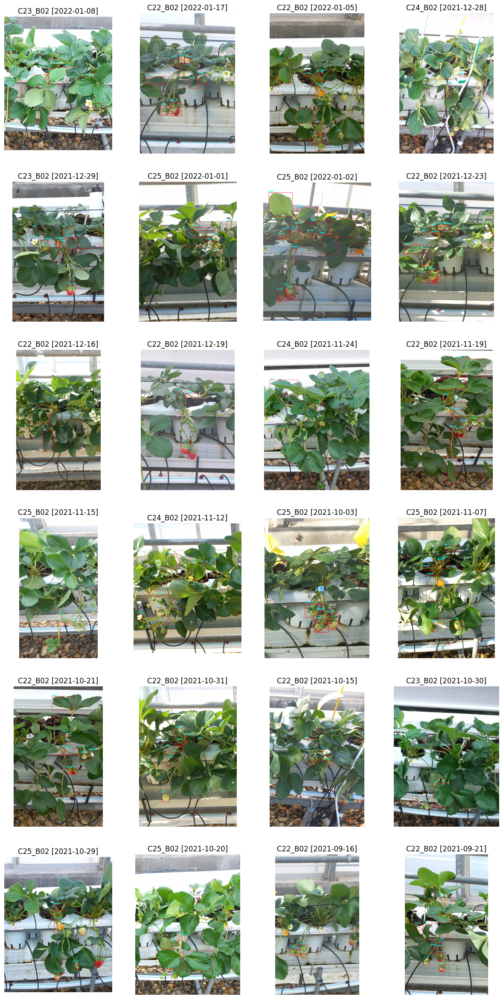

In [ ]:
show_sample_image(extract_df, gs_list[4], 24, src_dir, isbbox=True)

## generate dataset

In [ ]:
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/DLP/YOLO_train_data2.csv")
tlist = df['fname'].values.tolist()
tlist[:5], len(tlist)

(['C24_B02_004_753149',
  'C24_B02_006_753180',
  'C24_B02_004_753163',
  'C24_B02_006_753173',
  'C24_B02_004_753184'],
 3220)

In [ ]:
cls_dict={"정식기":"transplant","출뢰기":"flowerbud","개화기":"blossoming","과실비대기":"fruitenlarge","수확기":"harvesting"}
df['growth_stage'] = df['growth_stage'].map(cls_dict)
df.head(2)

,fname,image_id,farm_id,crops_id,crops_type,growth_stage,c_date,c_time,env1,env2,growth_info,etc_info,img_width,img_height,bbox_num,annotations,categories
0,C24_B02_004_753149,753149,AIF005,C24_B02,딸기 금실,harvesting,2022-01-08,14:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1094,1480,10,"[{'segmentation': [227.02, 638.54, 274.49, 638...","[{'id': 0, 'name': '화방', 'supercategory': 'non..."
1,C24_B02_006_753180,753180,AIF005,C24_B02,딸기 금실,fruitenlarge,2022-01-09,10:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1023,1521,11,"[{'segmentation': [462.85, 823.13, 558.72, 823...","[{'id': 0, 'name': '과실', 'supercategory': 'non..."


In [ ]:
gs_df = df['growth_stage'].value_counts().to_frame(name='count').sort_values(by='count')
gs_df['ratio'] = (gs_df['count']/gs_df['count'].sum() * 100).round()
gs_df

,count,ratio
growth_stage,,
transplant,302,9.0
flowerbud,386,12.0
blossoming,636,20.0
fruitenlarge,946,29.0
harvesting,950,30.0


### - train EDA

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec

# 축 서식 지정
def format_spines(ax, right_ax=False):
    # Setting up colors
    ax.spines['bottom'].set_color('#CCCCCC') #--> 라이트 그레이(Light Gray)
    ax.spines['left'].set_color('#CCCCCC')
    ax.spines['top'].set_visible(False) #--> top 축은 그리지 않는다.
    if right_ax:
        ax.spines['right'].set_color('#CCCCCC')
    else:
        ax.spines['right'].set_color('#FFFFFF') #--> 흰색
    ax.patch.set_facecolor('#FFFFFF')


def set_axis(ax, title='', xlabel='', ylabel='', angle=None, pad=20, right_ax=False):
    format_spines(ax, right_ax)
    if angle:
        for tick in ax.get_xticklabels():
            tick.set(fontsize=12)
            tick.set_rotation(angle)
    else:
        for tick in ax.get_xticklabels():
            tick.set(fontsize=12)
    if len(xlabel):   ax.set_xlabel(xlabel, fontsize=13)
    if len(ylabel):   ax.set_ylabel(ylabel, fontsize=13)
    if len(title):    ax.set_title(title, size=17, weight="bold", color='dimgrey', pad=pad)


def text_annotate(ax, with_p=False, ncount=None):
    for p in ax.patches:
        if with_p:
            x = p.get_bbox().get_points()[:, 0]
            y = p.get_bbox().get_points()[1, 1]
            ax.annotate(
				text='{}\n{:.1f}%'.format(int(y), 100. * y / ncount), xy=(x.mean(), y),
				ha='center', va='bottom', fontsize=12, color='darkblue'
			)
        else:
            ax.annotate(
				text=f"{int(p.get_height())}", xy=(p.get_x()+p.get_width()/2, p.get_height()), xytext=(0,7),
				ha='center', va='center', textcoords='offset points', fontsize=12, color='darkblue'
			)

<ipython-input-6-9c0120b239e5>:28: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


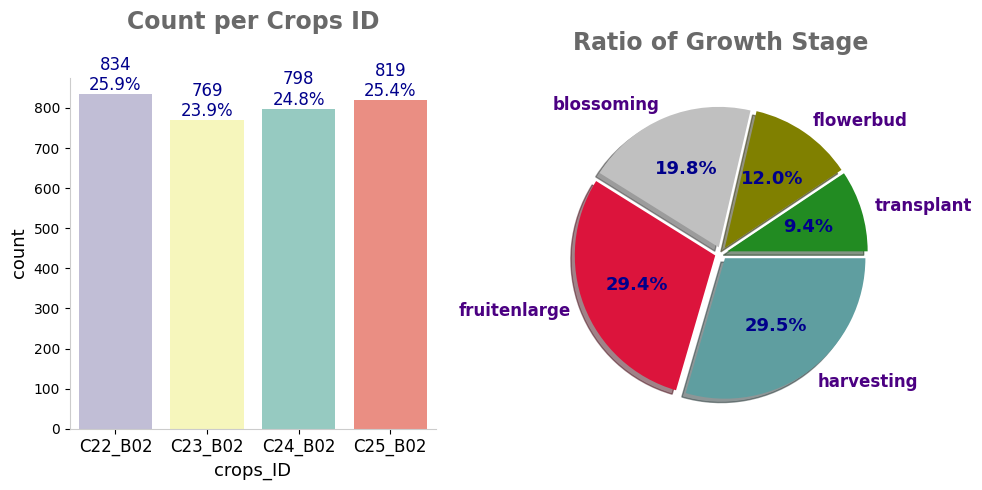

In [ ]:
fig = plt.figure(constrained_layout=True, figsize=(10, 5))

# GridSpec
gs = GridSpec(1,2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

# ax1
sns.countplot(
    data=df, x='crops_id', ax=ax1, hue='crops_id', legend=False, palette='Set3',
    order=['C22_B02','C23_B02','C24_B02','C25_B02']
)
ncount = len(df)
text_annotate(ax=ax1, with_p=True, ncount=ncount)
set_axis(ax=ax1, title="Count per Crops ID", xlabel="crops_ID", ylabel="count", pad=35)

# ax2
explode = [0.045, 0.045,  0.045, 0.045, 0.045]
gs_colors = ['forestgreen', 'olive', 'silver', 'crimson','cadetblue']
_, _, autotexts = ax2.pie(
	gs_df['count'].values, labels=gs_df.index, autopct='%.1f%%',
	explode=explode, shadow=True, colors=gs_colors,
    textprops={'fontsize': 12, 'color': 'indigo', 'weight': 'bold'}
);
plt.setp(autotexts, size=13, weight="bold", color='darkblue')
ax2.set_title("Ratio of Growth Stage", size=17, weight="bold", color='dimgrey', pad=20)

plt.show()

-----

### - code test

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/label_data_json/extracted_train/"

img_width, img_height, annotations, categories = get_info(json_dir, tlist[0])
cl, ct, cr, cb = get_crop_points(annotations, img_width, img_height)
cl, ct, cr, cb #--> crop : left, top, right, bottom

(107, 398, 797, 993)

In [ ]:
image_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/train/images/"
if not os.path.isfile(image_dir + tlist[0] + ".jpg"):
    raise ValueError("Image file not found:", tlist[0])

img = cv2.imread(image_dir+tlist[0]+".jpg")
crop_img = img[ct:cb, cl:cr].copy()
crop_h, crop_w = crop_img.shape[:2]
crop_h, crop_w

(595, 690)

In [ ]:
cv2.imwrite("/content/drive/MyDrive/DLP/"+tlist[0]+".jpg", crop_img)

True

In [ ]:
txt_labels = get_bbox_text(annotations, categories, cl, ct, crop_w, crop_h)
txt_labels

['2 0.2083405797 0.4497226891 0.0687971014 0.090907563',
 '2 0.2843695652 0.3647058824 0.0634927536 0.0736470588',
 '2 0.3861666667 0.3817226891 0.1081304348 0.126302521',
 '3 0.4552173913 0.4599663866 0.1290144928 0.1523697479',
 '3 0.4427753623 0.5409915966 0.1057246377 0.0722689076',
 '3 0.376942029 0.5568403361 0.1153623188 0.1952268908',
 '1 0.7627173913 0.3486470588 0.1274057971 0.2483193277',
 '0 0.2998623188 0.2778655462 0.1378405797 0.0881008403',
 '1 0.5099130435 0.2492184874 0.0935072464 0.0922857143',
 '1 0.6719927536 0.5421680672 0.0551449275 0.5124033613']

In [ ]:
save_dir = "/content/drive/MyDrive/DLP"

save_bbox_text(save_dir, tlist[0], txt_labels)

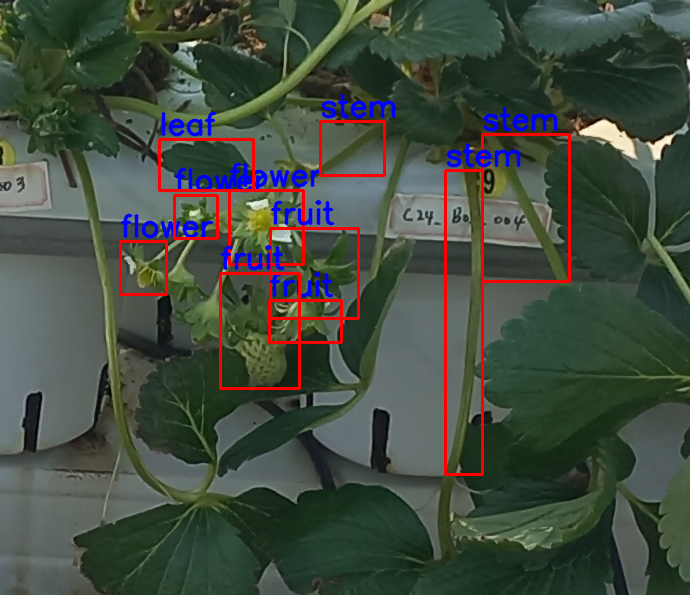

In [ ]:
draw_bboxes(img, annotations, categories)
test_img = img[ct:cb, cl:cr].copy()
cv2_imshow(test_img)

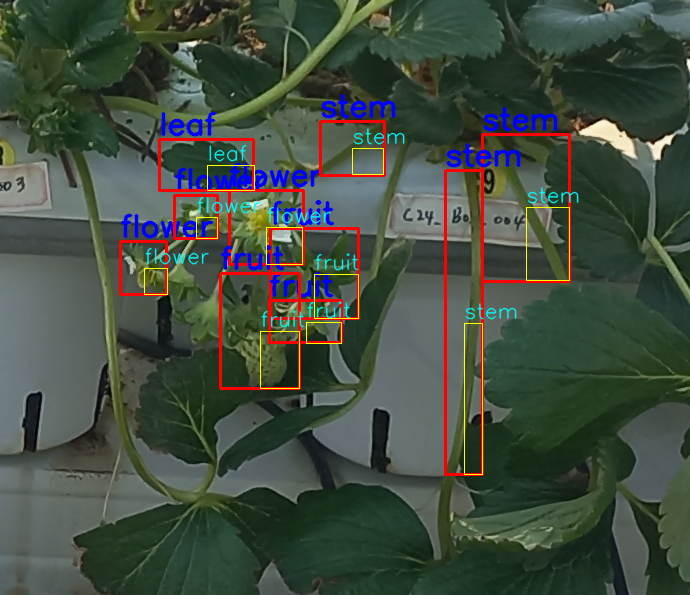

In [ ]:
for label in txt_labels:
    info = list(map(float, label.split()))
    cx = int(round(info[1] * crop_w))
    cy = int(round(info[2] * crop_h))
    hw = int(round(info[3] * crop_w / 2))
    hh = int(round(info[4] * crop_h / 2))
    cv2.rectangle(test_img, rec=(cx, cy, hw, hh), color=(0,255,255), thickness=1)
    cv2.putText(
        test_img,
        text=eng_class[category[int(info[0])]], org=(cx, cy-5),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.7,
        color=(255,255,0), thickness=1, lineType=cv2.LINE_AA
    )
cv2_imshow(test_img)

-----

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/label_data_json/extracted_train/"
image_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/train/images/"
save_img_dir = "/content/drive/MyDrive/DLP/YOLO_data/train/images/"
save_txt_dir = "/content/drive/MyDrive/DLP/YOLO_data/train/labels/"

In [ ]:
crop_dataset_generator(tlist, json_dir, image_dir, save_img_dir, save_txt_dir)

Processing:   0%|          | 0/3220 [00:00<?, ?it/s]

In [ ]:
img_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/train/images")
txt_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/train/labels")
len(img_list), len(txt_list)

(3220, 3220)

In [ ]:
img_list = [x.split('.')[0] for x in img_list]
for v in txt_list:
    if v.split('.')[0] not in img_list:
        print(v)

<br></br>

# valid

## data sampling

In [ ]:
vm_df = pd.read_csv("/content/drive/MyDrive/DLP/valid_meta_data.csv")
vm_df

,fname,image_id,farm_id,crops_id,crops_type,growth_stage,c_date,c_time,env1,env2,growth_info,etc_info,img_width,img_height,bbox_num,annotations,categories
0,C25_B02_003_423515,423515,AIF005,C25_B02,딸기 금실,수확기,2021-10-28,17:19:57,"{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'corps_id': 'C25_B02', 'measured_date': None,...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1279,1846,4,"[{'segmentation': [974.95, 750.08, 1065.6, 750...","[{'id': 0, 'name': '화방', 'supercategory': 'non..."
1,C24_B02_005_455867,455867,AIF005,C24_B02,딸기 금실,정식기,2021-08-28,18:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1509,2074,10,"[{'segmentation': [1051.97, 353.79, 1072.78, 3...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
2,C24_B02_005_455902,455902,AIF005,C24_B02,딸기 금실,정식기,2021-08-28,13:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1509,2074,9,"[{'segmentation': [518.9, 637.79, 552.78, 637....","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
3,C24_B02_005_455944,455944,AIF005,C24_B02,딸기 금실,정식기,2021-08-28,07:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1509,2074,7,"[{'segmentation': [630.78, 553.87, 867.58, 553...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
4,C24_B02_005_455965,455965,AIF005,C24_B02,딸기 금실,정식기,2021-08-27,16:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1509,2074,5,"[{'segmentation': [1055.42, 345.51, 1078.63, 3...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3020,C25_B02_007_703415,703415,AIF005,C25_B02,딸기 금실,출뢰기,2021-12-29,13:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': '2021...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1228,1470,8,"[{'segmentation': [501.2, 889.41, 594.15, 889....","[{'id': 0, 'name': '과실', 'supercategory': 'non..."
3021,C25_B02_007_715784,715784,AIF005,C25_B02,딸기 금실,출뢰기,2021-12-31,08:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': None,...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1229,1472,7,"[{'segmentation': [424.9, 900.26, 525.81, 900....","[{'id': 0, 'name': '과실', 'supercategory': 'non..."
3022,C25_B02_007_715896,715896,AIF005,C25_B02,딸기 금실,출뢰기,2022-01-01,14:44:31,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C25_B02', 'measured_date': None,...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1229,1472,6,"[{'segmentation': [335.17, 959.88, 452.02, 959...","[{'id': 0, 'name': '과실', 'supercategory': 'non..."
3023,C25_B02_007_731337,731337,AIF005,C25_B02,딸기 금실,출뢰기,2022-01-03,09:44:31,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C25_B02', 'measured_date': None,...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1229,1472,10,"[{'segmentation': [288.05, 839.03, 398.68, 839...","[{'id': 0, 'name': '과실', 'supercategory': 'non..."


In [ ]:
vgs_df = vm_df['growth_stage'].value_counts().to_frame()
vgs_df['ratio'] = (vgs_df['count'] / len(vm_df) * 100).round(2)
vgs_df

,count,ratio
growth_stage,,
수확기,1039,34.35
출뢰기,700,23.14
정식기,553,18.28
과실비대기,502,16.60
개화기,231,7.64


In [ ]:
vm_df['crops_id'].value_counts().to_frame()

,count
crops_id,
C24_B02,827
C25_B02,806
C22_B02,756
C23_B02,636


In [ ]:
gs_list = ['정식기','출뢰기','개화기','과실비대기','수확기']

for id in ['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']:
    print(f"-- < {id} > --")
    for gs in gs_list:
        print(f" {gs} -->", end=" ")
        print(len(vm_df.query(f"crops_id=='{id}' & growth_stage=='{gs}' & bbox_num > 3")))

-- < C22_B02 > --
 정식기 --> 114
 출뢰기 --> 189
 개화기 --> 67
 과실비대기 --> 94
 수확기 --> 198
-- < C23_B02 > --
 정식기 --> 86
 출뢰기 --> 99
 개화기 --> 57
 과실비대기 --> 167
 수확기 --> 160
-- < C24_B02 > --
 정식기 --> 111
 출뢰기 --> 145
 개화기 --> 20
 과실비대기 --> 117
 수확기 --> 272
-- < C25_B02 > --
 정식기 --> 133
 출뢰기 --> 131
 개화기 --> 64
 과실비대기 --> 88
 수확기 --> 322


In [ ]:
valid_data = []

for id in ['C22_B02', 'C23_B02', 'C24_B02', 'C25_B02']:
    transplant = vm_df.query(f"crops_id=='{id}' & growth_stage=='정식기' & bbox_num > 3")['fname'].values.tolist()
    valid_data += random.sample(population=transplant, k=10)

    flowerbud = vm_df.query(f"crops_id=='{id}' & growth_stage=='출뢰기' & bbox_num > 3")['fname'].values.tolist()
    valid_data += random.sample(population=flowerbud, k=10)

    blossoming = vm_df.query(f"crops_id=='{id}' & growth_stage=='개화기' & bbox_num > 3")['fname'].values.tolist()
    valid_data += random.sample(population=blossoming, k=20)

    fruitenlarge = vm_df.query(f"crops_id=='{id}' & growth_stage=='과실비대기' & bbox_num > 3")['fname'].values.tolist()
    valid_data += random.sample(population=fruitenlarge, k=30)

    harvesting = vm_df.query(f"crops_id=='{id}' & growth_stage=='수확기' & bbox_num > 3")['fname'].values.tolist()
    valid_data += random.sample(population=harvesting, k=30)

len(valid_data), len(set(valid_data))

400

In [ ]:
df = vm_df[vm_df['fname'].isin(valid_data)]
df

,fname,image_id,farm_id,crops_id,crops_type,growth_stage,c_date,c_time,env1,env2,growth_info,etc_info,img_width,img_height,bbox_num,annotations,categories
3,C24_B02_005_455944,455944,AIF005,C24_B02,딸기 금실,정식기,2021-08-28,07:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1509,2074,7,"[{'segmentation': [630.78, 553.87, 867.58, 553...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
9,C24_B02_005_456732,456732,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-03,17:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1520,2084,11,"[{'segmentation': [835.62, 546.82, 893.95, 546...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
18,C24_B02_005_457752,457752,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-09,11:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1532,2096,5,"[{'segmentation': [696.05, 974.93, 885.63, 974...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
27,C24_B02_005_458738,458738,AIF005,C24_B02,딸기 금실,과실비대기,2021-09-24,06:33:13,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1540,2104,4,"[{'segmentation': [973.23, 776.92, 1260.54, 77...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
28,C24_B02_005_458745,458745,AIF005,C24_B02,딸기 금실,과실비대기,2021-09-24,07:33:13,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1540,2104,4,"[{'segmentation': [707.58, 566.15, 1047, 566.1...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2958,C24_B02_004_734473,734473,AIF005,C24_B02,딸기 금실,수확기,2022-01-04,16:15:16,"{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'farm_id': 'AIF005', 'receive_date': '2022-01...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1089,1475,13,"[{'segmentation': [532.67, 612.87, 548.38, 612...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
2969,C24_B02_005_421718,421718,AIF005,C24_B02,딸기 금실,수확기,2021-10-11,11:33:13,"{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1310,1896,5,"[{'segmentation': [582.48, 1472.49, 651.29, 14...","[{'id': 0, 'name': '과실', 'supercategory': 'non..."
2977,C24_B02_005_425657,425657,AIF005,C24_B02,딸기 금실,수확기,2021-10-15,11:33:13,"{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'farm_id': 'AIF005', 'receive_date': '2021-10...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1276,1880,13,"[{'segmentation': [329.41, 329.8, 586.96, 329....","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
2998,C24_B02_005_455592,455592,AIF005,C24_B02,딸기 금실,정식기,2021-08-27,07:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'farm_id': 'AIF005', 'receive_date': '2021-08...","{'corps_id': 'C24_B02', 'measured_date': None,...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1507,2071,10,"[{'segmentation': [1058.11, 454.26, 1105.91, 4...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."


In [ ]:
vgs_df = df['growth_stage'].value_counts().to_frame()
vgs_df['ratio'] = (vgs_df['count'] / len(df) * 100).round(2)
vgs_df

,count,ratio
growth_stage,,
과실비대기,120,30.0
수확기,120,30.0
개화기,80,20.0
정식기,40,10.0
출뢰기,40,10.0


In [ ]:
print(sorted(df['bbox_num'].unique()), df['bbox_num'].values.sum())

[4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21] 3177


In [ ]:
df.to_csv("/content/drive/MyDrive/DLP/YOLO_valid_data3.csv", index=False)

### - 데이터 확인

--- < 정식기(transplant) : 40 > --- 



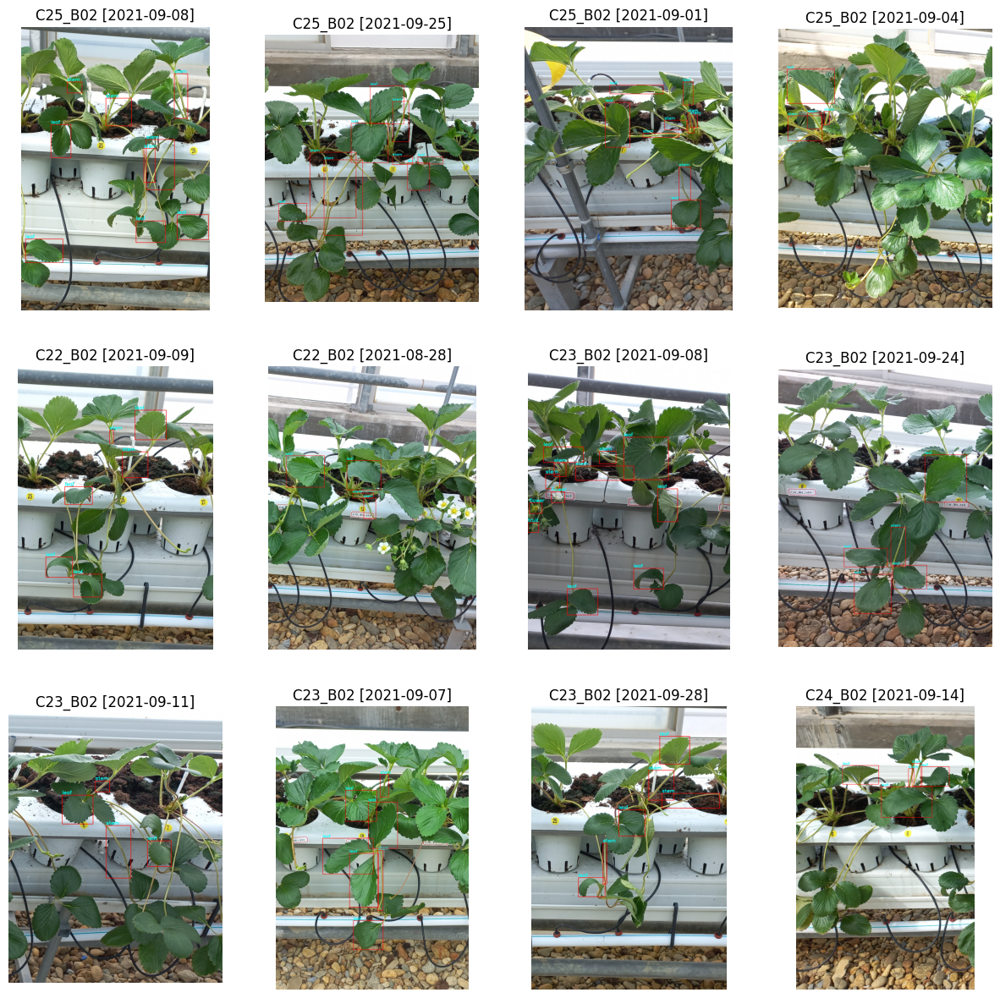

In [ ]:
src_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/valid/images/"

show_sample_image(df, gs_list[0], 12, src_dir, istrain=False, isbbox=True)

--- < 출뢰기(flower_bud) : 40 > --- 



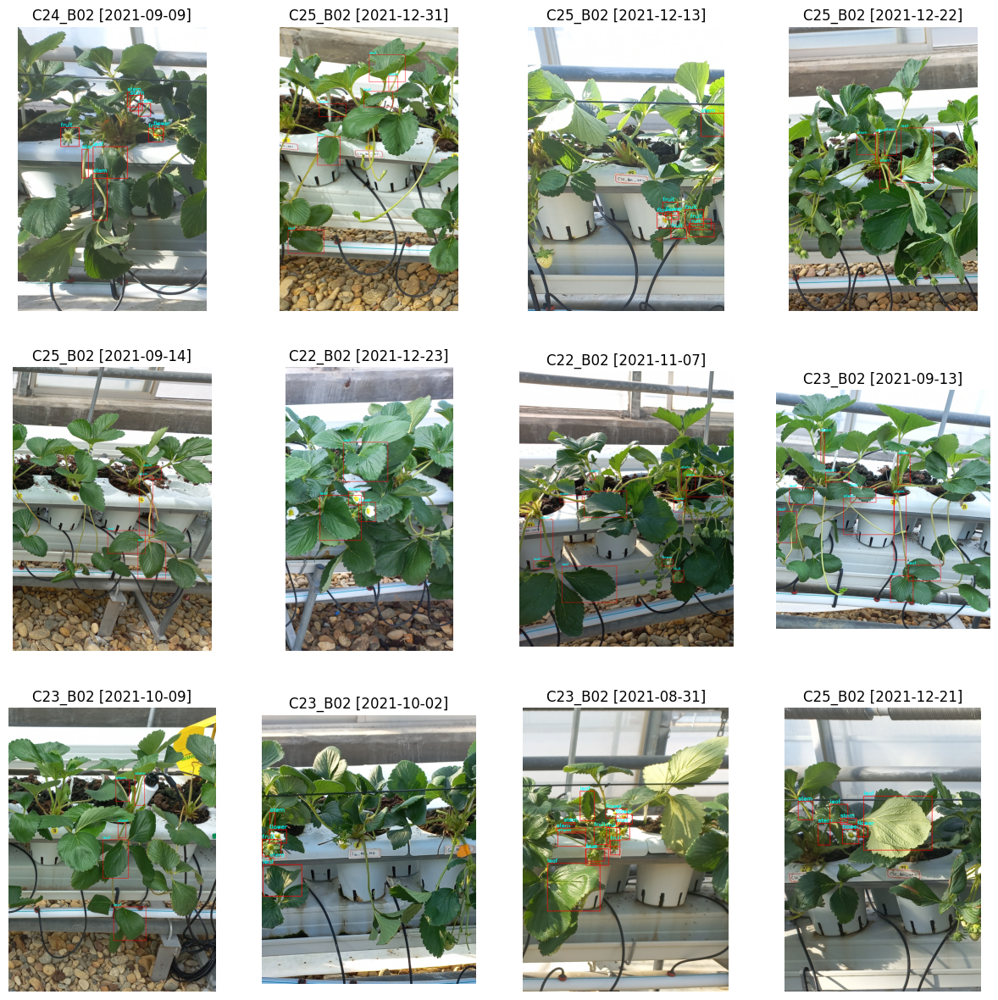

In [ ]:
show_sample_image(df, gs_list[1], 12, src_dir, istrain=False, isbbox=True)

--- < 개화기(blossoming) : 80 > --- 



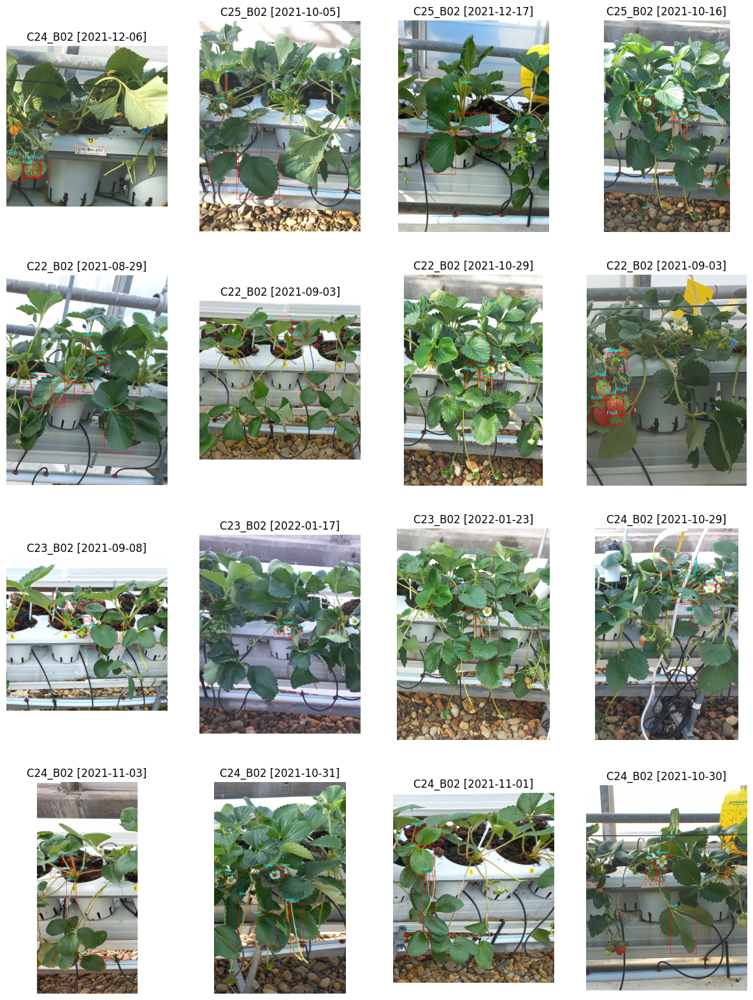

In [ ]:
show_sample_image(df, gs_list[2], 16, src_dir, istrain=False, isbbox=True)

--- < 과실비대기(fruit_enlarge) : 120 > --- 



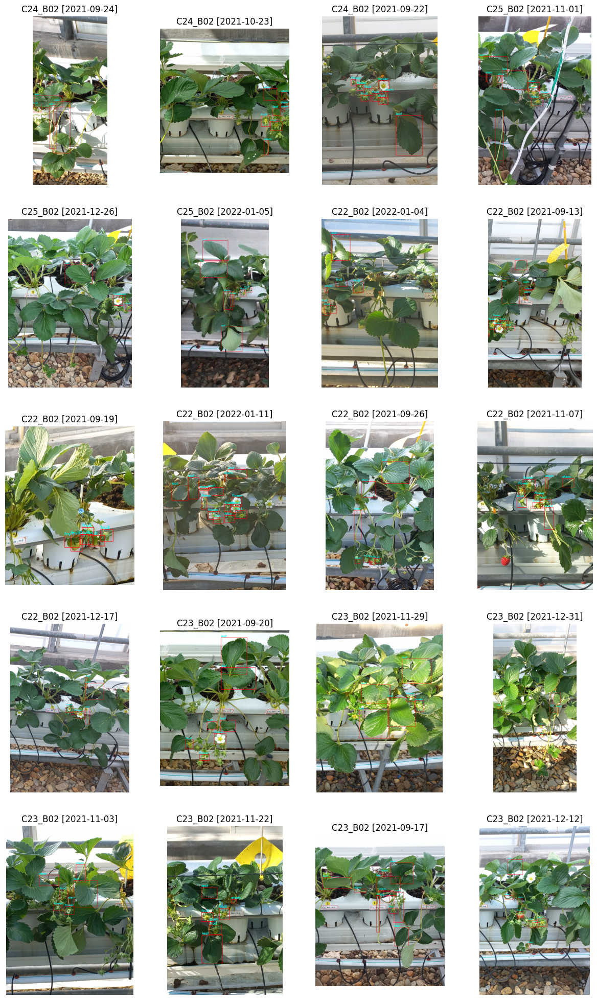

In [ ]:
show_sample_image(df, gs_list[3], 20, src_dir, istrain=False, isbbox=True)

--- < 수확기(harvesting) : 120 > --- 



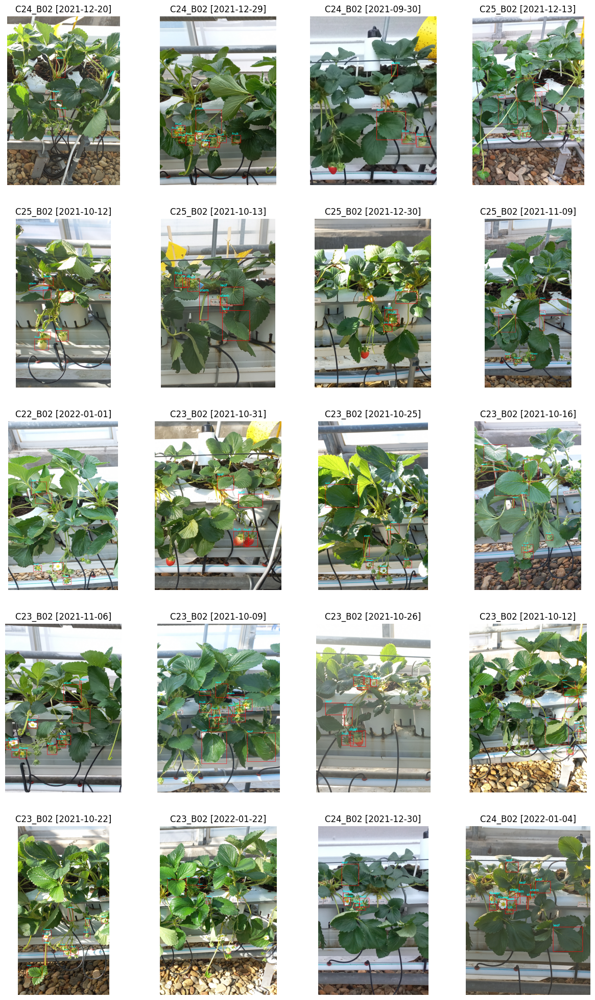

In [ ]:
show_sample_image(df, gs_list[4], 20, src_dir, istrain=False, isbbox=True)

## generate dataset

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/DLP/YOLO_valid_data2.csv")
vlist = df['fname'].values.tolist()
vlist[:5], len(vlist)

(['C24_B02_005_458854',
  'C24_B02_005_459344',
  'C24_B02_005_459516',
  'C24_B02_005_459875',
  'C24_B02_005_482476'],
 400)

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/label_data_json/extracted_valid/"
image_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/valid/images/"
save_img_dir = "/content/drive/MyDrive/DLP/YOLO_data/valid/images/"
save_txt_dir = "/content/drive/MyDrive/DLP/YOLO_data/valid/labels/"

crop_dataset_generator(vlist, json_dir, image_dir, save_img_dir, save_txt_dir)

Processing:   0%|          | 0/400 [00:00<?, ?it/s]

In [ ]:
img_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/valid/images")
txt_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/valid/labels")
len(img_list), len(txt_list)

(400, 400)

In [ ]:
img_list = [x.split('.')[0] for x in img_list]
for v in txt_list:
    if v.split('.')[0] not in img_list:
        print(v)

<br></br>

# test

## data sampling

In [ ]:
ex_df = pd.read_csv("/content/drive/MyDrive/DLP/dataset/valid_ex_data.csv", index_col=0)
ex_df.reset_index(drop=True, inplace=True)
ex_df

,fname,image_id,farm_id,crops_id,crops_type,growth_stage,c_date,c_time,env1,env2,growth_info,etc_info,img_width,img_height,bbox_num,annotations,categories
0,C24_B02_005_457647,457647,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-08,09:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': '2021...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1532,2096,4,"[{'segmentation': [487.58, 486.96, 716, 486.96...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
1,C24_B02_005_457682,457682,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-08,13:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': '2021...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1532,2096,5,"[{'segmentation': [707.06, 1020.1, 894.59, 102...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
2,C24_B02_005_457703,457703,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-08,17:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': '2021...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1532,2096,5,"[{'segmentation': [847.06, 428.14, 1058.19, 42...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
3,C24_B02_005_457846,457846,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-15,08:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': '2021...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1531,2096,4,"[{'segmentation': [761.26, 1477.93, 1001.93, 1...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
4,C24_B02_005_457871,457871,AIF005,C24_B02,딸기 금실,출뢰기,2021-09-15,12:46:29,"{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'farm_id': 'AIF005', 'receive_date': '2021-09...","{'corps_id': 'C24_B02', 'measured_date': '2021...","{'corps_id': 'C24_B02', 'create_date': '', 'in...",1531,2096,4,"[{'segmentation': [706, 508.61, 886.76, 508.61...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
349,C25_B02_007_622134,622134,AIF005,C25_B02,딸기 금실,수확기,2021-12-15,15:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': '2021...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1154,1759,10,"[{'segmentation': [201.88, 578.45, 371.61, 578...","[{'id': 0, 'name': '잎', 'supercategory': 'none..."
350,C25_B02_007_622142,622142,AIF005,C25_B02,딸기 금실,수확기,2021-12-15,16:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': '2021...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1154,1759,6,"[{'segmentation': [506.83, 834.03, 590.99, 834...","[{'id': 0, 'name': '과실', 'supercategory': 'non..."
351,C25_B02_007_693965,693965,AIF005,C25_B02,딸기 금실,출뢰기,2021-12-29,10:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': '2021...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1228,1470,5,"[{'segmentation': [589.71, 458.09, 896.11, 458...","[{'id': 0, 'name': '줄기', 'supercategory': 'non..."
352,C25_B02_007_703415,703415,AIF005,C25_B02,딸기 금실,출뢰기,2021-12-29,13:44:31,"{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'farm_id': 'AIF005', 'receive_date': '2021-12...","{'corps_id': 'C25_B02', 'measured_date': '2021...","{'corps_id': 'C25_B02', 'create_date': '', 'in...",1228,1470,8,"[{'segmentation': [501.2, 889.41, 594.15, 889....","[{'id': 0, 'name': '과실', 'supercategory': 'non..."


In [ ]:
fname_list = ex_df['fname'].values.tolist()
len(fname_list)

354

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/dataset/label_data_json/decomp_valid/"

for fname in tqdm(fname_list):
    if not os.path.isfile(json_dir + fname + ".json"):
        raise ValueError("Json file not found:", fname)

  0%|          | 0/354 [00:00<?, ?it/s]

In [ ]:
import json
from datetime import datetime

df_data = dict(
    fname=[], crops_id=[], crops_type=[], growth_stage=[], c_date=[], c_time=[],
    img_width=[], img_height=[], bbox_num=[], class_num=[], class_name=[]
)
growth_info=[];

for f_name in tqdm(fname_list, desc='Processing'):
    with open(os.path.join(json_dir, f_name+".json"), 'r') as f:
        data = json.load(f)

    df_data['fname'].append(f_name)
    val = data['images']['crops_id']
    df_data['crops_id'].append(val if val else None)
    val = data['images']['crops'] +" "+ data['images']['kind_type']
    df_data['crops_type'].append(val if val else None)
    val = data['images']['growth_stage']
    df_data['growth_stage'].append(val if val else None)
    val = datetime.strptime(data['images']['date_captured'], "%Y-%m-%d %H:%M:%S")
    df_data['c_date'].append(val.date() if val else None)
    df_data['c_time'].append(val.time() if val else None)
    val = int(data['images']['width'])
    df_data['img_width'].append(val if val else None)
    val = int(data['images']['height'])
    df_data['img_height'].append(val if val else None)
    anno = data['annotations']
    df_data['bbox_num'].append(len(anno))
    cate = data['categories']
    class_name = set()
    for c in cate:
        class_name.add(c['name'])
    df_data['class_num'].append(len(class_name))
    df_data['class_name'].append(class_name)

    gi = dict(fname=f_name)
    gi.update(data['growth_index'])
    gi.update(data['etc_infor'])
    growth_info.append(gi)

Processing:   0%|          | 0/354 [00:00<?, ?it/s]

In [ ]:
base_df = pd.DataFrame(df_data)
base_df

,fname,crops_id,crops_type,growth_stage,c_date,c_time,img_width,img_height,bbox_num,class_num,class_name
0,C24_B02_005_457647,C24_B02,딸기 금실,출뢰기,2021-09-08,09:46:29,1532,2096,4,2,"{줄기, 잎}"
1,C24_B02_005_457682,C24_B02,딸기 금실,출뢰기,2021-09-08,13:46:29,1532,2096,5,2,"{줄기, 잎}"
2,C24_B02_005_457703,C24_B02,딸기 금실,출뢰기,2021-09-08,17:46:29,1532,2096,5,2,"{줄기, 잎}"
3,C24_B02_005_457846,C24_B02,딸기 금실,출뢰기,2021-09-15,08:46:29,1531,2096,4,2,"{줄기, 잎}"
4,C24_B02_005_457871,C24_B02,딸기 금실,출뢰기,2021-09-15,12:46:29,1531,2096,4,3,"{줄기, 잎, 화방}"
...,...,...,...,...,...,...,...,...,...,...,...
349,C25_B02_007_622134,C25_B02,딸기 금실,수확기,2021-12-15,15:44:31,1154,1759,10,4,"{줄기, 과실, 잎, 화방}"
350,C25_B02_007_622142,C25_B02,딸기 금실,수확기,2021-12-15,16:44:31,1154,1759,6,3,"{줄기, 과실, 화방}"
351,C25_B02_007_693965,C25_B02,딸기 금실,출뢰기,2021-12-29,10:44:31,1228,1470,5,1,{줄기}
352,C25_B02_007_703415,C25_B02,딸기 금실,출뢰기,2021-12-29,13:44:31,1228,1470,8,3,"{줄기, 과실, 잎}"


In [ ]:
growth_info_df = pd.DataFrame(growth_info)
growth_info_df.drop(columns=['bloom3_date','fr3_cnt','create_date','inform'], inplace=True)
growth_info_df

,fname,corps_id,measured_date,stem_length,leaf_cnt,leaf_width,leaf_length,stem_thick,bloom1_date,bloom2_date,fr1_cnt,fr2_cnt,fr_weight
0,C24_B02_005_457647,C24_B02,2021-09-08,40.5,8,7.5,10.6,11.5,None,None,None,None,None
1,C24_B02_005_457682,C24_B02,2021-09-08,40.5,8,7.5,10.6,11.5,None,None,None,None,None
2,C24_B02_005_457703,C24_B02,2021-09-08,40.5,8,7.5,10.6,11.5,None,None,None,None,None
3,C24_B02_005_457846,C24_B02,2021-09-15,40.9,9,8.1,11.2,11.8,None,None,None,None,None
4,C24_B02_005_457871,C24_B02,2021-09-15,40.9,9,8.1,11.2,11.8,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...
349,C25_B02_007_622134,C25_B02,2021-12-15,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
350,C25_B02_007_622142,C25_B02,2021-12-15,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
351,C25_B02_007_693965,C25_B02,2021-12-29,30.5,7,10.4,12.5,16,2021-10-27,None,None,None,None
352,C25_B02_007_703415,C25_B02,2021-12-29,30.5,7,10.4,12.5,16,2021-10-27,None,None,None,None


In [ ]:
df = base_df.merge(growth_info_df, how='left', on='fname')
df = df.drop(columns='corps_id')
df

,fname,crops_id,crops_type,growth_stage,c_date,c_time,img_width,img_height,bbox_num,class_num,...,stem_length,leaf_cnt,leaf_width,leaf_length,stem_thick,bloom1_date,bloom2_date,fr1_cnt,fr2_cnt,fr_weight
0,C24_B02_005_457647,C24_B02,딸기 금실,출뢰기,2021-09-08,09:46:29,1532,2096,4,2,...,40.5,8,7.5,10.6,11.5,None,None,None,None,None
1,C24_B02_005_457682,C24_B02,딸기 금실,출뢰기,2021-09-08,13:46:29,1532,2096,5,2,...,40.5,8,7.5,10.6,11.5,None,None,None,None,None
2,C24_B02_005_457703,C24_B02,딸기 금실,출뢰기,2021-09-08,17:46:29,1532,2096,5,2,...,40.5,8,7.5,10.6,11.5,None,None,None,None,None
3,C24_B02_005_457846,C24_B02,딸기 금실,출뢰기,2021-09-15,08:46:29,1531,2096,4,2,...,40.9,9,8.1,11.2,11.8,None,None,None,None,None
4,C24_B02_005_457871,C24_B02,딸기 금실,출뢰기,2021-09-15,12:46:29,1531,2096,4,3,...,40.9,9,8.1,11.2,11.8,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
349,C25_B02_007_622134,C25_B02,딸기 금실,수확기,2021-12-15,15:44:31,1154,1759,10,4,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
350,C25_B02_007_622142,C25_B02,딸기 금실,수확기,2021-12-15,16:44:31,1154,1759,6,3,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
351,C25_B02_007_693965,C25_B02,딸기 금실,출뢰기,2021-12-29,10:44:31,1228,1470,5,1,...,30.5,7,10.4,12.5,16,2021-10-27,None,None,None,None
352,C25_B02_007_703415,C25_B02,딸기 금실,출뢰기,2021-12-29,13:44:31,1228,1470,8,3,...,30.5,7,10.4,12.5,16,2021-10-27,None,None,None,None


In [ ]:
weight_df = df[~df['fr_weight'].isnull()]
weight_df

,fname,crops_id,crops_type,growth_stage,c_date,c_time,img_width,img_height,bbox_num,class_num,...,stem_length,leaf_cnt,leaf_width,leaf_length,stem_thick,bloom1_date,bloom2_date,fr1_cnt,fr2_cnt,fr_weight
8,C24_B02_005_507981,C24_B02,딸기 금실,수확기,2021-11-17,15:23:21,1566,2131,8,3,...,29.1,9,7,11.2,15.8,2021-09-29,2021-11-10,2,None,19
9,C24_B02_005_573845,C24_B02,딸기 금실,수확기,2021-12-01,16:23:21,1376,2153,7,3,...,29.2,9,8.7,13.5,17.1,2021-09-29,2021-11-10,None,3,22
10,C24_B02_005_594654,C24_B02,딸기 금실,수확기,2021-12-08,10:23:21,1038,2165,7,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
11,C24_B02_005_606180,C24_B02,딸기 금실,수확기,2021-12-08,12:23:21,1048,2176,8,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
12,C24_B02_005_606192,C24_B02,딸기 금실,수확기,2021-12-08,14:23:21,1048,2176,11,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
346,C24_B02_005_427020,C24_B02,딸기 금실,수확기,2021-11-03,08:23:21,1410,2002,11,4,...,28.4,9,8.8,13.5,13.8,2021-09-29,None,7,None,5
347,C25_B02_007_622102,C25_B02,딸기 금실,수확기,2021-12-15,11:44:31,1154,1759,10,4,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
348,C25_B02_007_622110,C25_B02,딸기 금실,수확기,2021-12-15,12:44:31,1154,1759,10,3,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
349,C25_B02_007_622134,C25_B02,딸기 금실,수확기,2021-12-15,15:44:31,1154,1759,10,4,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10


In [ ]:
weight_df['growth_stage'].value_counts().to_frame()

,count
growth_stage,
수확기,100
과실비대기,1


In [ ]:
test_df = weight_df.query('bbox_num>3 & class_num>2')
test_df

,fname,crops_id,crops_type,growth_stage,c_date,c_time,img_width,img_height,bbox_num,class_num,...,stem_length,leaf_cnt,leaf_width,leaf_length,stem_thick,bloom1_date,bloom2_date,fr1_cnt,fr2_cnt,fr_weight
8,C24_B02_005_507981,C24_B02,딸기 금실,수확기,2021-11-17,15:23:21,1566,2131,8,3,...,29.1,9,7,11.2,15.8,2021-09-29,2021-11-10,2,None,19
9,C24_B02_005_573845,C24_B02,딸기 금실,수확기,2021-12-01,16:23:21,1376,2153,7,3,...,29.2,9,8.7,13.5,17.1,2021-09-29,2021-11-10,None,3,22
10,C24_B02_005_594654,C24_B02,딸기 금실,수확기,2021-12-08,10:23:21,1038,2165,7,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
11,C24_B02_005_606180,C24_B02,딸기 금실,수확기,2021-12-08,12:23:21,1048,2176,8,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
12,C24_B02_005_606192,C24_B02,딸기 금실,수확기,2021-12-08,14:23:21,1048,2176,11,3,...,28.4,10,8.8,13.7,17.4,2021-09-29,2021-11-10,None,5,22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
346,C24_B02_005_427020,C24_B02,딸기 금실,수확기,2021-11-03,08:23:21,1410,2002,11,4,...,28.4,9,8.8,13.5,13.8,2021-09-29,None,7,None,5
347,C25_B02_007_622102,C25_B02,딸기 금실,수확기,2021-12-15,11:44:31,1154,1759,10,4,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
348,C25_B02_007_622110,C25_B02,딸기 금실,수확기,2021-12-15,12:44:31,1154,1759,10,3,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10
349,C25_B02_007_622134,C25_B02,딸기 금실,수확기,2021-12-15,15:44:31,1154,1759,10,4,...,30.5,7,9.3,13.9,15.6,2021-10-27,None,None,None,10


### - 데이터 확인

--- < 수확기(harvesting) : 75 > --- 



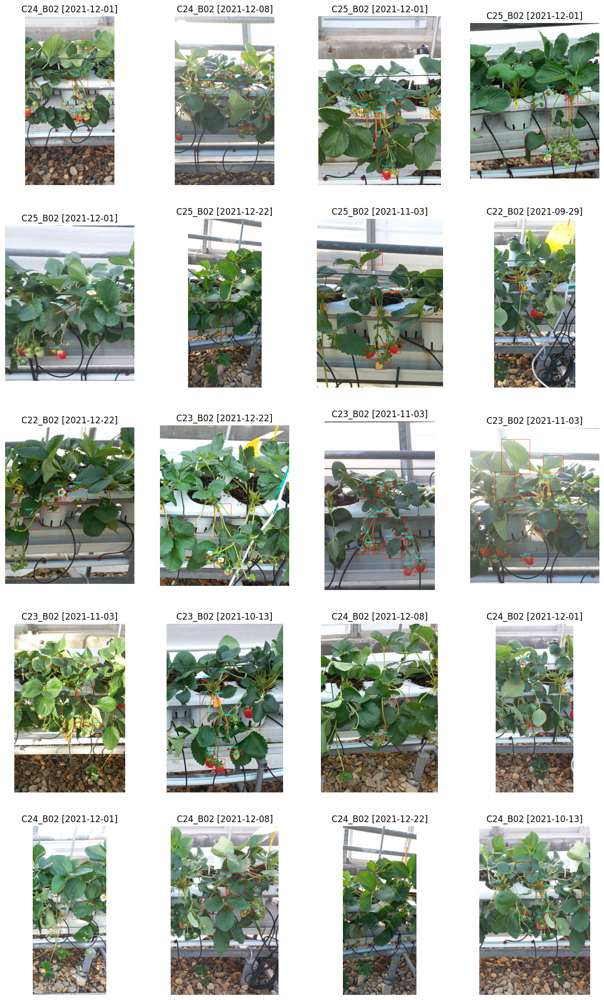

In [ ]:
src_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/valid/images/"
show_sample_image(test_df, "수확기", 20, src_dir, istrain=False, isbbox=True)

## generate dataset

In [ ]:
# wt_df = pd.read_csv("/content/drive/MyDrive/DLP/test_weights_data.csv")
tslist = test_df['fname'].values.tolist()
tslist[:5], len(tslist)

(['C24_B02_005_507981',
  'C24_B02_005_573845',
  'C24_B02_005_594654',
  'C24_B02_005_606180',
  'C24_B02_005_606192'],
 76)

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/label_data_json/extracted_valid/"
image_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/valid/images/"
save_img_dir = "/content/drive/MyDrive/DLP/YOLO_data/test/images/"
save_txt_dir = "/content/drive/MyDrive/DLP/YOLO_data/test/labels/"

# croped image
crop_dataset_generator(tslist, json_dir, image_dir, save_img_dir, save_txt_dir)

Processing:   0%|          | 0/76 [00:00<?, ?it/s]

In [ ]:
json_dir = "/content/drive/MyDrive/DLP/[DS]_Deep_Learning_Project/strawberry/valid/labels"

# origial image
for fname in tqdm(tslist, desc='Processing'):
    src = os.path.join(image_dir, fname+'.jpg')
    dst = os.path.join(save_img_dir, fname+'.jpg')
    shutil.copyfile(src, dst)

    src = os.path.join(json_dir, fname+'.txt')
    dst = os.path.join(save_txt_dir, fname+'.txt')
    shutil.copyfile(src, dst)

Processing:   0%|          | 0/76 [00:00<?, ?it/s]

In [ ]:
img_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/test/images")
txt_list = os.listdir("/content/drive/MyDrive/DLP/YOLO_data/test/labels")
len(img_list), len(txt_list)

(76, 76)

In [ ]:
img_list = [x.split('.')[0] for x in img_list]
for v in txt_list:
    if v.split('.')[0] not in img_list:
        print(v)